In [1]:
# ! pip install geopandas matplotlib
# ! pip install contextily
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely.geometry import Point


In [2]:
data =pd.read_excel("./data/horn_bill_telemetry.xlsx")

df = pd.DataFrame(data)

df['timestamp'] = pd.to_datetime(df['timestamp'], format='%m/%d/%y %H:%M')

# Extract month and year
df['month'] = df['timestamp'].dt.month
df['month_name'] = df['timestamp'].dt.strftime('%B')  # Get month name for better readability
df['year'] = df['timestamp'].dt.year

In [14]:
# dark_colors = {
#     'January': '#003f5c',
#     'February': '#2f4b7c',
#     'March': '#665191',
#     'April': '#a05195',
#     'May': '#d45087',
#     'June': '#f95d6a',
#     'July': '#ff7c43',
#     'August': '#ffa600',
#     'September': '#ff4500',
#     'October': '#ff6347',
#     'November': '#ff1493',
#     'December': '#d2691e'
# }

dark_colors = {
    'January': '#ff9999',    # Soft red
    'February': '#ffcc99',   # Light orange
    'March': '#ff9966',      # Peach
    'April': '#66b3ff',      # Soft blue
    'May': '#99ff99',        # Light green
    'June': '#c2c2f0',       # Lavender
    'July': '#ffb3e6',       # Soft pink
    'August': '#c4e17f',     # Lime
    'September': '#ffeb3b',  # Bright yellow
    'October': '#ff9d9d',    # Salmon
    'November': '#9e7fbb',   # Light purple
    'December': '#e6b8b7'    # Rosy beige
}



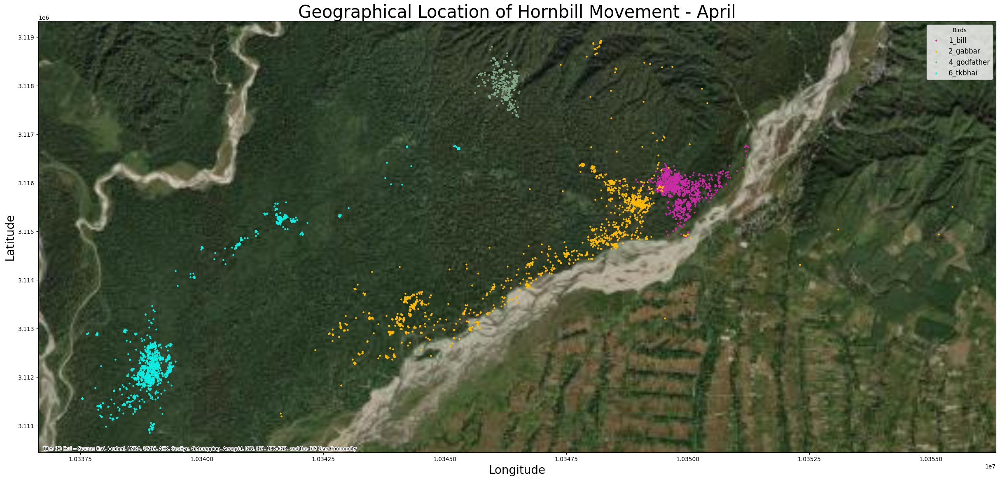

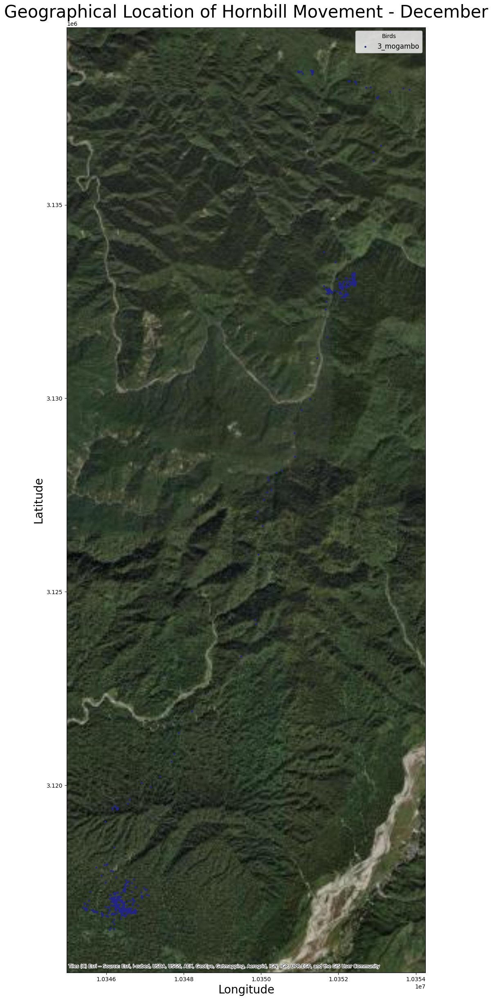

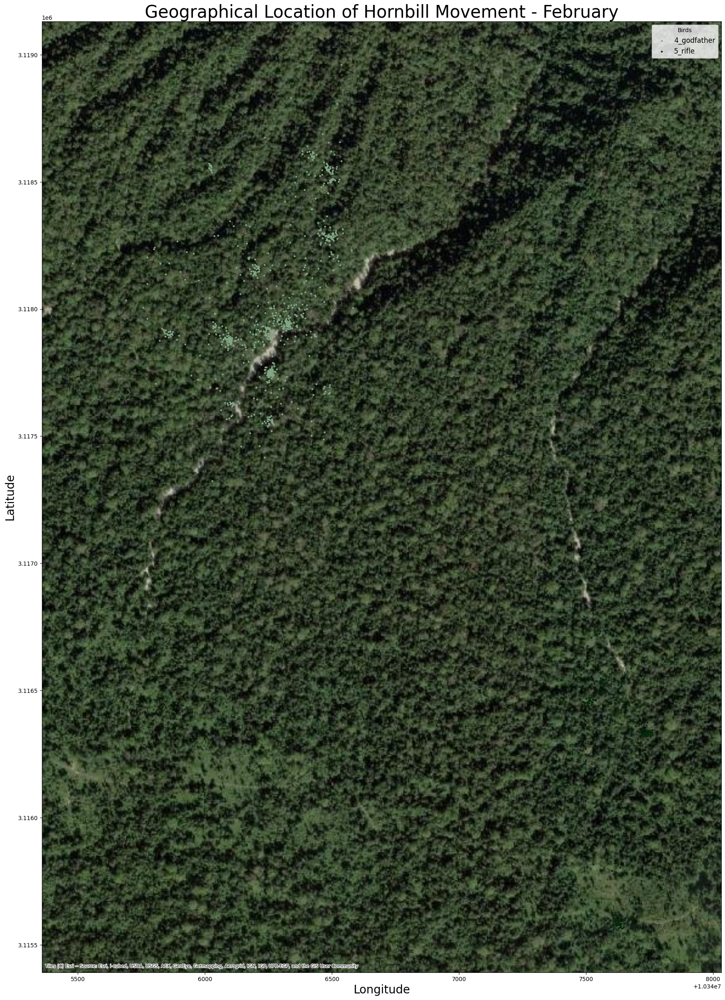

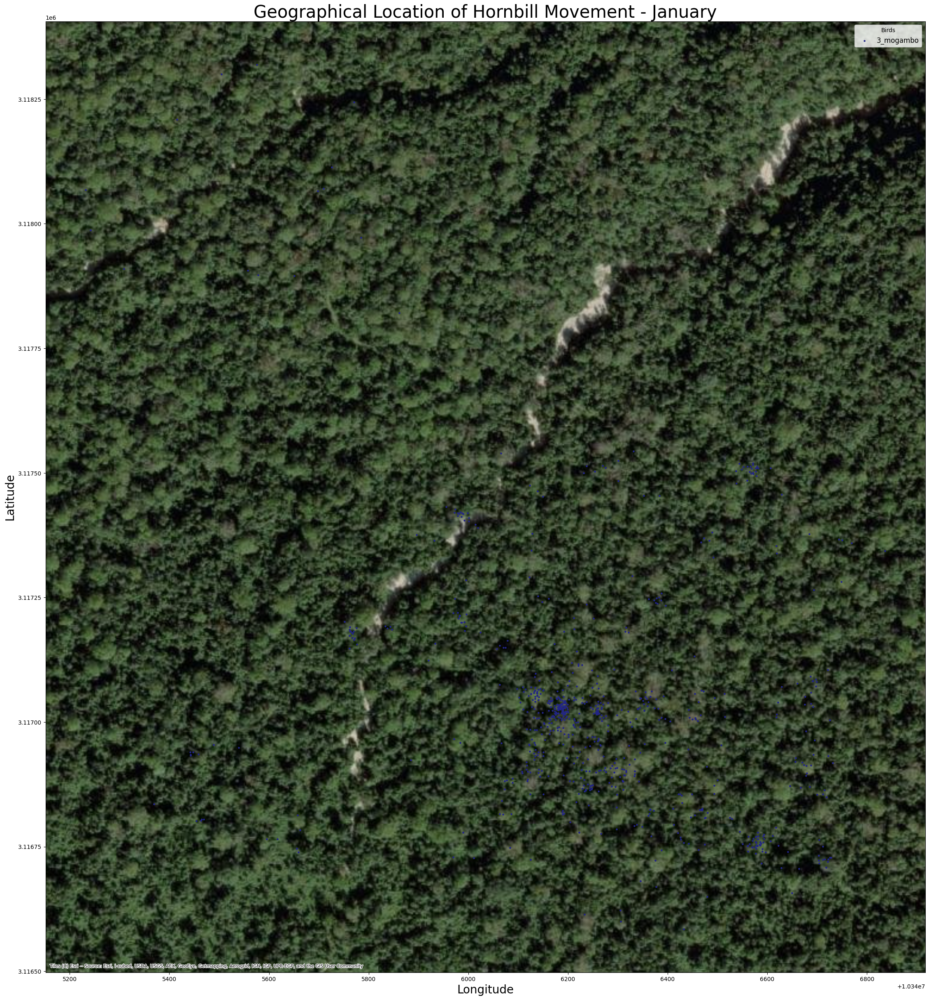

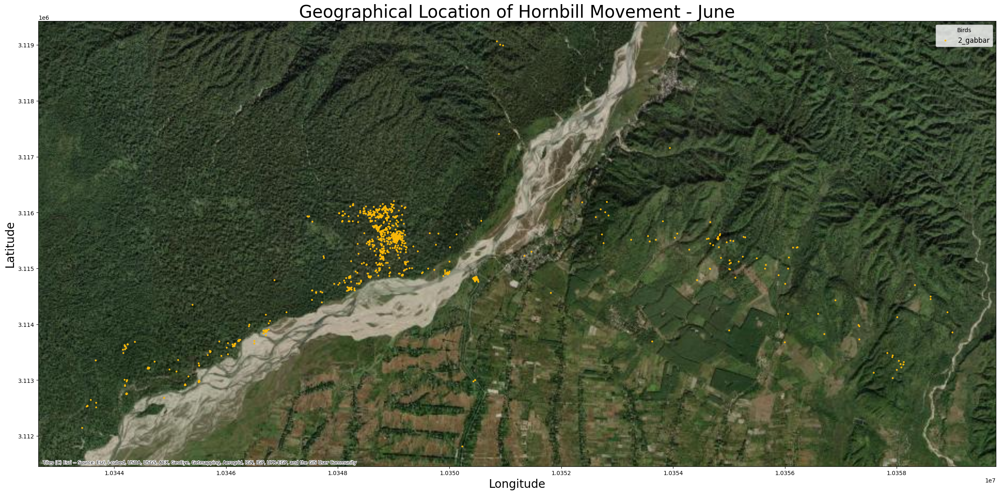

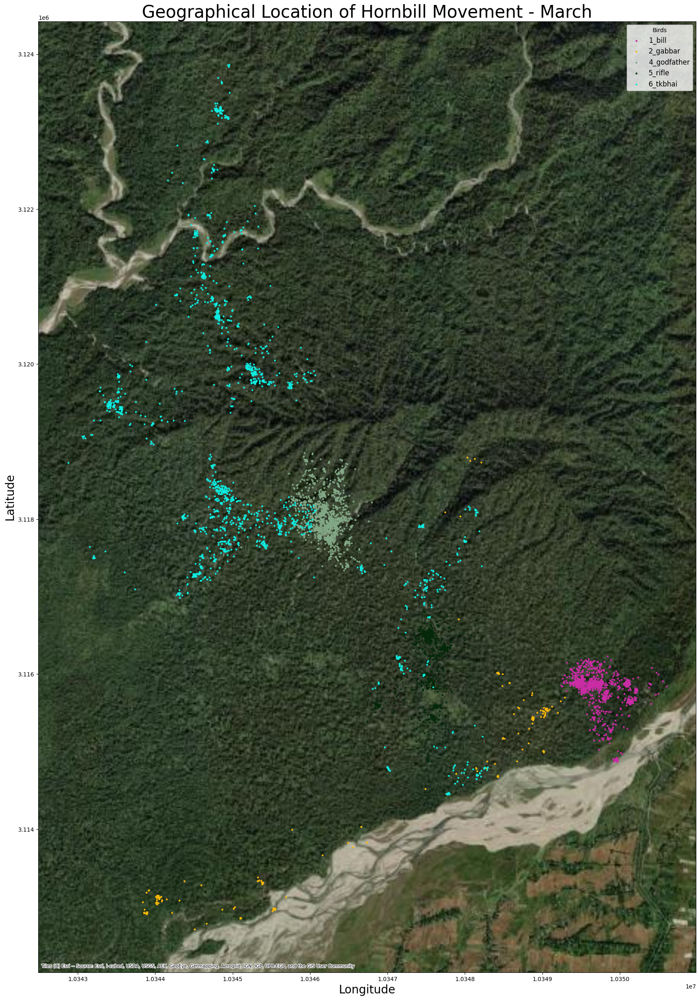

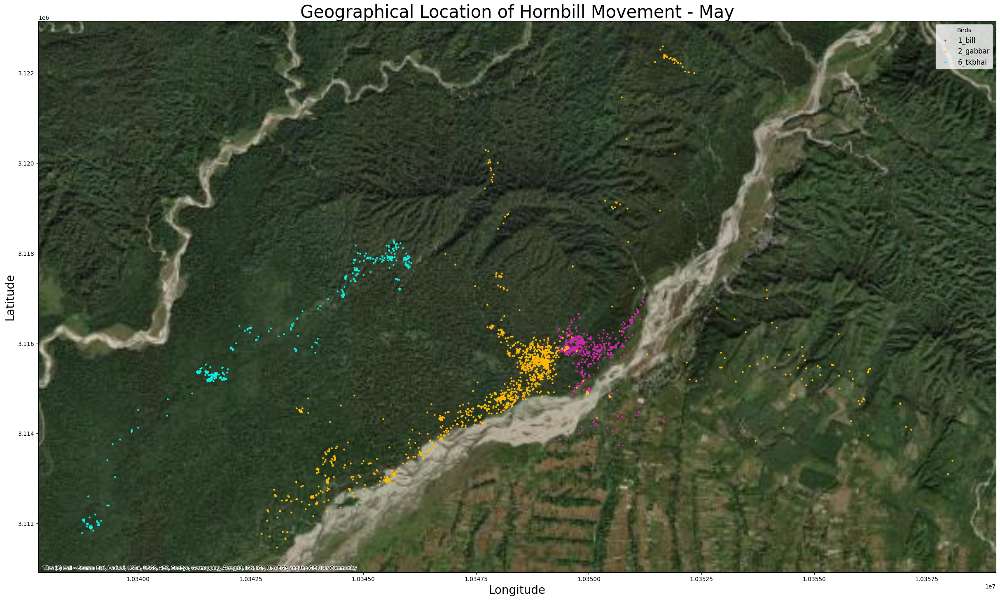

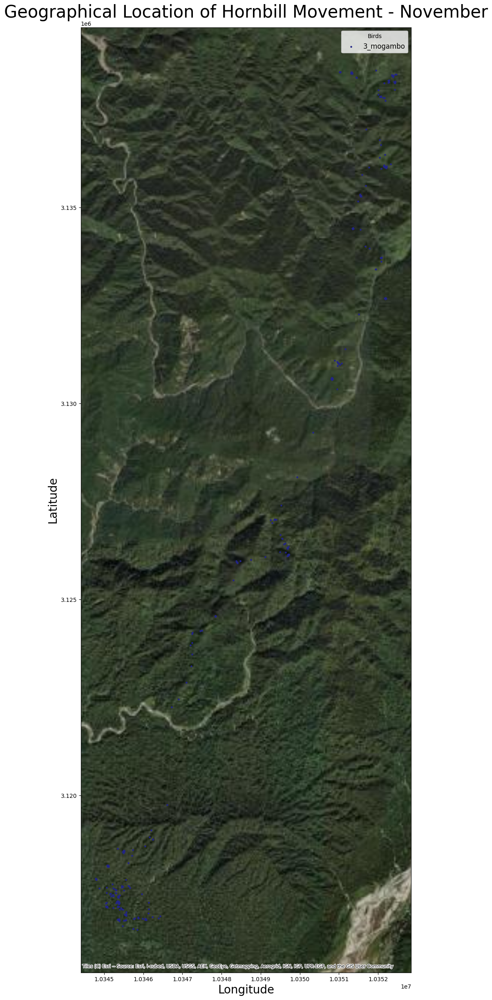

In [23]:
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import random

# Create a GeoDataFrame
geometry = [Point(xy) for xy in zip(df['location-long'], df['location-lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry)

# Set the coordinate reference system (CRS)
geo_df.set_crs(epsg=4326, inplace=True)

# Convert to Web Mercator projection for contextily
geo_df = geo_df.to_crs(epsg=3857)

# Get unique identifiers for the birds
unique_birds = geo_df['individual-local-identifier'].unique()

# Generate distinct colors for each bird
colors = {bird: '#' + ''.join([random.choice('0123456789ABCDEF') for _ in range(6)]) for bird in unique_birds}

# Create a figure for each month
for month_name, group in geo_df.groupby('month_name'):
    fig, ax = plt.subplots(figsize=(30, 30))
    
    # Plot the points for each bird in its unique color
    for bird in unique_birds:
        bird_group = group[group['individual-local-identifier'] == bird]
        if not bird_group.empty:
            bird_group.plot(ax=ax, color=colors[bird], marker='o', markersize=5, label=bird)

    # Add satellite basemap
    ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)

    # Set titles and labels
    ax.set_title(f'Geographical Location of Hornbill Movement - {month_name}', fontsize=30)
    ax.set_xlabel('Longitude', fontsize=20)
    ax.set_ylabel('Latitude', fontsize=20)

    # Add legend for birds
    ax.legend(title='Birds', fontsize=12)

    # Show the plot
    plt.show()


# LILU map

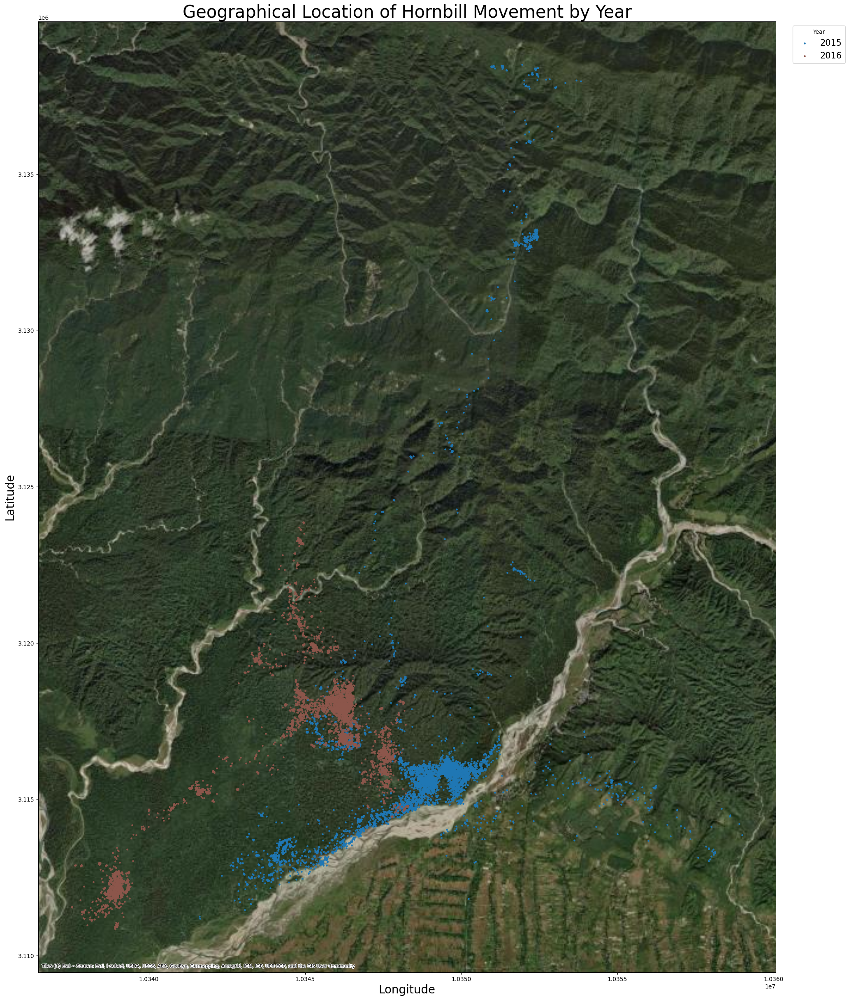

In [5]:
geometry = [Point(xy) for xy in zip(df['location-long'], df['location-lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry)

fig, ax = plt.subplots(figsize=(50, 30))

# Set the coordinate reference system (CRS)
geo_df.set_crs(epsg=4326, inplace=True)

# Convert to Web Mercator projection for contextily
geo_df = geo_df.to_crs(epsg=3857)

# Create a color map for each year
colors = plt.colormaps.get_cmap('tab10')

# Plot each year's data with a different color
for i, (year, group) in enumerate(geo_df.groupby('year')):
    group.plot(ax=ax, color=colors(i / len(geo_df['year'].unique())), marker='o', markersize=5, label=str(year))

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)

# Add titles and labels
plt.title('Geographical Location of Hornbill Movement by Year', fontsize=30)
plt.xlabel('Longitude', fontsize=20)
plt.ylabel('Latitude', fontsize=20)

# Add a legend to indicate which color represents which year
plt.legend(title='Year', loc='upper right', bbox_to_anchor=(1.1, 1), fontsize=15)

# Show the plot
plt.show()

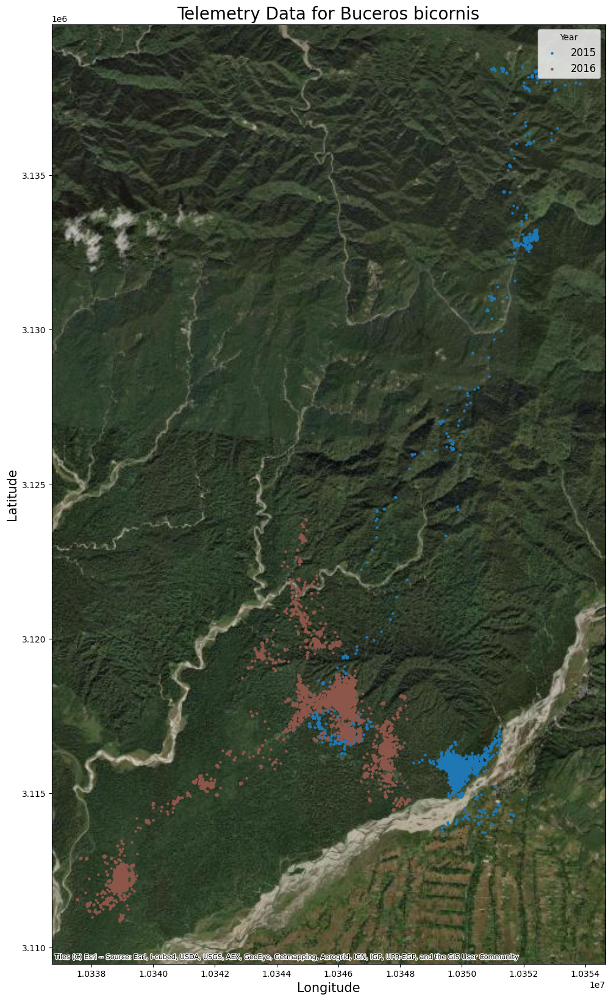

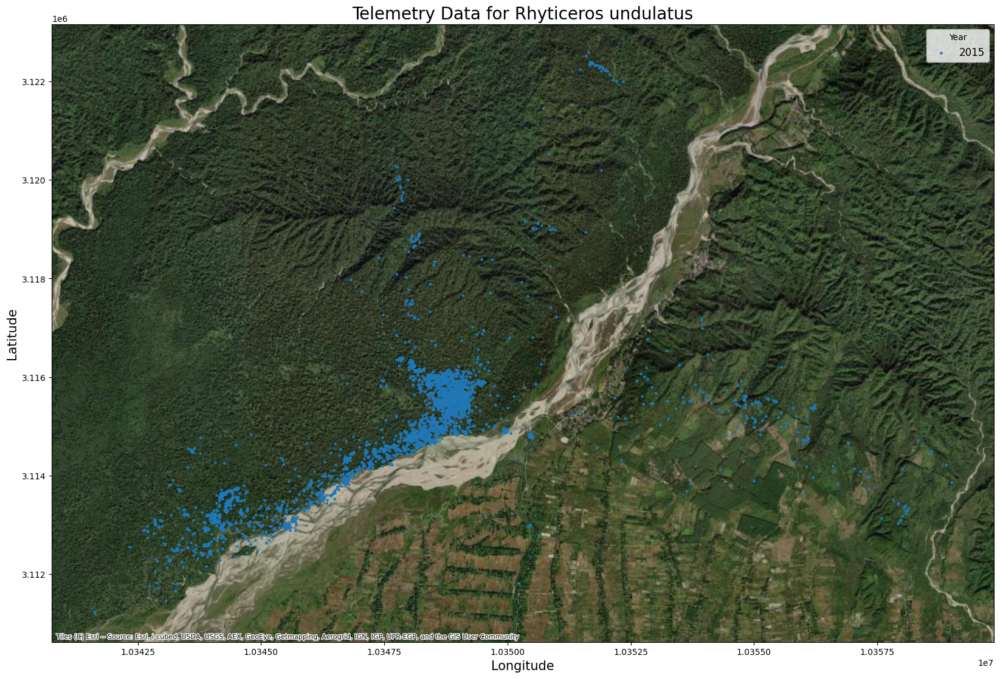

In [6]:
taxon_names = geo_df['individual-taxon-canonical-name'].unique()

# Create a color map for each year
colors = plt.colormaps.get_cmap('tab10')

# Plot each taxon species with different colors for each year
for taxon in taxon_names:
    # Filter data for the current taxon
    taxon_df = geo_df[geo_df['individual-taxon-canonical-name'] == taxon]
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(20, 20))
    
    # Plot each year's data with different colors
    for i, (year, group) in enumerate(taxon_df.groupby('year')):
        group.plot(ax=ax, color=colors(i / len(taxon_df['year'].unique())), marker='o', markersize=5, label=str(year))
    
    # Add basemap
    ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
    
    # Add titles and labels
    plt.title(f'Telemetry Data for {taxon}', fontsize=20)
    plt.xlabel('Longitude', fontsize=15)
    plt.ylabel('Latitude', fontsize=15)
    
    # Add legend
    plt.legend(title='Year', loc='upper right', fontsize=12)
    
    # Show the plot
    plt.show()